In [ ]:
%matplotlib inline

import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import seaborn as sns

# plt.rcParams["figure.figsize"] = (15, 10)
plt.rcParams["figure.dpi"] = 125
plt.rcParams["font.size"] = 12
plt.rcParams['font.family'] = ['sans-serif']
plt.rcParams['font.sans-serif'] = ['DejaVu Sans']
plt.style.use('ggplot')
sns.set_style("whitegrid", {'axes.grid': False})
plt.rcParams['image.cmap'] = 'viridis' # grayscale looks better

In [ ]:
import torch
import pandas as pd
import numpy as np
import seaborn as sns
from PIL import Image

from isic.dataset import preprocess_df, SkinDataset, SkinDataModule
from isic.config import *

# Dataset Features

## Skin cancer type: Các bệnh ung thư da

Excerpts from the paper:

>The HAM10000 Dataset: A Large Collection of Multi-Source Dermatoscopic Images of Common Pigmented Skin Lesions  
    https://arxiv.org/abs/1803.10417

**nv**

Melanocytic nevi are benign neoplasms of melanocytes and appear in a myriad of variants, which all are included in our series. The variants may differ significantly from a dermatoscopic point of view.

Nốt ruồi là những khối u lành tính của tế bào hắc tố và xuất hiện trong vô số biến thể. Các biến thể có thể khác nhau đáng kể theo quan điểm soi da.

\[6705 images\]

**mel**

Melanoma is a malignant neoplasm derived from melanocytes that may appear in different variants. If excised in an early stage it can be cured by simple surgical excision. Melanomas can be invasive or non-invasive (in situ). We included all variants of melanoma including melanoma in situ, but did exclude non-pigmented, subungual, ocular or mucosal melanoma.

Ung thư hắc tố là một loại ung thư ác tính có nguồn gốc từ các biến thể khác nhau của tế bào hắc tố. Nếu cắt bỏ ở giai đoạn đầu, nó có thể được chữa khỏi bằng phẫu thuật đơn giản. U hắc tố có thể xâm lấn hoặc không (tại chỗ). Bộ dữ liệu bao gồm tất cả các biến thể của khối u ác tính bao gồm khối u ác tính tại chỗ, nhưng đã loại trừ khối u ác tính không sắc tố, dưới mắt, mắt hoặc niêm mạc.

\[1113 images\]

**bkl**

"Benign keratosis" is a generic class that includes seborrheic keratoses ("senile wart"), solar lentigo - which can be regarded a flat variant of seborrheic keratosis - and lichen-planus like keratoses (LPLK), which corresponds to a seborrheic keratosis or a solar lentigo with inflammation and regression [22]. The three subgroups may look different dermatoscopically, but we grouped them together because they are similar biologically and often reported under the same generic term histopathologically. From a dermatoscopic view, lichen planus-like keratoses are especially challenging because they can show morphologic features mimicking melanoma [23] and are often biopsied or excised for diagnostic reasons.

"Dày sừng lành tính" là một nhóm chung bao gồm các bệnh lý da tiết bã ("mụn cóc tuổi già"), mụn thịt mặt trời - có thể được coi là một biến thể phẳng của dày sừng tiết bã - và tiết bã sừng như lichen-phẳng (LPLK), tương ứng với u bã đậu dày sừng hoặc đồi mồi với tình trạng viêm và thoái triển [22]. Ba phân nhóm có thể trông khác nhau về mặt da liễu, nhưng được nhóm lại với nhau vì chúng giống nhau về mặt sinh học và thường được báo cáo dưới cùng một thuật ngữ chung chung về mặt mô bệnh học. Từ quan điểm soi da, tiết bã sừng như lichen-phẳng rất thách thức vì chúng có thể cho thấy các đặc điểm hình thái giống khối u ác tính và thường được sinh thiết hoặc cắt bỏ để chẩn đoán.

\[1099 images\]

**bcc**

Basal cell carcinoma is a common variant of epithelial skin cancer that rarely metastasizes but grows destructively if untreated. It appears in different morphologic variants (flat, nodular, pigmented, cystic, etc) [21], which are all included in this set.

Ung thư biểu mô tế bào đáy là một biến thể phổ biến của ung thư da biểu mô, hiếm khi di căn nhưng phát triển hủy hoại nếu không được điều trị. Nó xuất hiện trong các biến thể hình thái khác nhau (phẳng, nốt sần, sắc tố, nang, v.v.), tất cả đều được bao gồm trong bộ dữ liệu này.

\[514 images\]

**akiec**

Actinic Keratoses (Solar Keratoses) and Intraepithelial Carcinoma (Bowen’s disease) are common non-invasive, variants of squamous cell carcinoma that can be treated locally without surgery. Some authors regard them as precursors of squamous cell carcinomas and not as actual carcinomas. There is, however, agreement that these lesions may progress to invasive squamous cell carcinoma - which is usually not pigmented. Both neoplasms commonly show surface scaling and commonly are devoid of pigment. Actinic keratoses are more common on the face and Bowen’s disease is more common on other body sites. Because both types are induced by UV-light the surrounding skin is usually typified by severe sun damaged except in cases of Bowen’s disease that are caused by human papilloma virus infection and not by UV. Pigmented variants exists for Bowen’s disease [19] and for actinic keratoses [20]. Both are included in this set.

Dày sừng quang hóa và bệnh Bowen là những biến thể không xâm lấn phổ biến của ung thư biểu mô tế bào vảy có thể điều trị tại chỗ mà không cần phẫu thuật. Một số chuyên gia coi chúng là tiền thân của ung thư biểu mô tế bào vảy chứ không phải là ung thư biểu mô. Tuy nhiên, không thể phủ nhận rằng những tổn thương này có thể tiến triển thành ung thư biểu mô tế bào vảy xâm lấn - thường không có sắc tố. Cả hai khối u thường cho thấy bề mặt lan rộng và thường không có sắc tố. Dày sừng quang hóa phổ biến hơn trên mặt và bệnh Bowen phổ biến hơn trên các vị trí khác trên cơ thể. Bởi vì cả hai loại đều gây ra bởi tia UV nên vùng da xung quanh thường được đặc trưng bởi ánh nắng mặt trời bị tổn thương nghiêm trọng, ngoại trừ các trường hợp bệnh Bowen do nhiễm vi rút u nhú ở người chứ không phải do tia UV. Các biến thể sắc tố đều có thể tồn tại đối với với hai căn bệnh trên. Cả hai đều có trong bộ dữ liệu.

\[327 images\]

**vasc**

Vascular skin lesions in the dataset range from cherry angiomas to angiokeratomas [25] and pyogenic granulomas [26]. Hemorrhage is also included in this category.

Những trường hợp về thương tổn mạch máu trong bộ dữ liệu bao gồm từ cherry angiomas (angiomas anh đào) đến u mạch và u hạt sinh mủ. Xuất huyết cũng được coi là một dạng của loại bệnh này.

\[142 images\]

**df**

Dermatofibroma is a benign skin lesion regarded as either a benign proliferation or an inflammatory reaction to minimal trauma. It is brown often showing a central zone of fibrosis dermatoscopically [24].

U xơ da là một tổn thương da lành tính được coi là một sự tăng sinh lành tính hoặc một phản ứng viêm do chấn thương tối thiểu. Nó có màu nâu thường cho thấy vùng trung tâm bị xơ hóa khi soi da.

\[115 images\]


**\[Total images = 10015\]**


## Method to diagnose label (dx_type): Phương pháp xác định bệnh

**NOTE** : More than 5000 images are histopathology, which have been performed by specialized dermatopathologists

1. **Histopathology(Histo)**: 
    - Histopathologic diagnoses of excised lesions have been performed by specialized dermatopathologists.
    - Chẩn đoán mô bệnh học của các tổn thương cắt bỏ được thực hiện bởi các bác sĩ chuyên khoa da liễu.
2. **Confocal**: 
    - Reflectance confocal microscopy is an in-vivo imaging technique with a resolution at near-cellular level.
    - Kính hiển vi tiêu điểm phản xạ là một kỹ thuật hình ảnh với độ phân giải ở cấp độ gần tế bào.
3. **Follow-up**: 
    - If nevi monitored by digital dermatoscopy did not show any changes during 3 follow-up visits or 1.5 years biologists accepted this as evidence of biologic benignity. Only nevi, but no other benign diagnoses were labeled with this type of ground-truth because dermatologists usually do not monitor dermatofibromas, seborrheic keratoses, or vascular lesions.
    - Nếu vết nốt ruồi được theo dõi bằng kỹ thuật soi da số không cho thấy bất kỳ thay đổi nào trong 3 lần tái khám hoặc 1,5 năm, các chuyên gia chấp nhận đây là bằng chứng về sự lành tính sinh học. Chỉ có nốt ruồi, ngoài ra không có chẩn đoán nào khác sử dụng phương pháp này vì bác sĩ da liễu thường không theo dõi u da, dày sừng tiết bã hoặc tổn thương mạch máu.
4. **Consensus**: 
    - For typical benign cases without histopathology or followup biologists provide an expert-consensus rating of authors PT and HK. They applied the consensus label only if both authors independently gave the same unequivocal benign diagnosis. Lesions with this type of groundtruth were usually photographed for educational reasons and did not need further follow-up or biopsy for confirmation.
    - Dành cho các trường hợp lành tính điển hình mà không dùng phương pháp Histopathology hoặc Follow-up, chúng sẽ được hai hội đồng đánh giá. Nhãn hợp lệ chỉ khi cả hai bên chuyên gia đều đưa ra cùng một chẩn đoán chung. Các tổn thương với loại hình nền này thường được chụp ảnh vì lý do giáo dục và không cần theo dõi thêm hoặc sinh thiết để xác nhận.

# Load dataframe

In [ ]:
df_path = PathConfig.CSV_PATH
valid_size = 0.2

In [ ]:
df = pd.read_csv(df_path)

In [ ]:
processed_df = pd.read_csv(df_path)
train_df, valid_df, labels = preprocess_df(processed_df, valid_size)
train_ds = SkinDataset(train_df, labels)
val_ds = SkinDataset(valid_df, labels)

In [ ]:
df

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear
...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face


In [ ]:
df.count()

lesion_id       10015
image_id        10015
dx              10015
dx_type         10015
age              9958
sex             10015
localization    10015
dtype: int64

In [ ]:
df.describe(include='all')

,lesion_id,image_id,dx,dx_type,age,sex,localization
count,10015,10015,10015,10015,9958.000000,10015,10015
unique,7470,10015,7,4,NaN,3,15
top,HAM_0003789,ISIC_0029065,nv,histo,NaN,male,back
freq,6,1,6705,5340,NaN,5406,2192
mean,NaN,NaN,NaN,NaN,51.863828,NaN,NaN
std,NaN,NaN,NaN,NaN,16.968614,NaN,NaN
min,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
25%,NaN,NaN,NaN,NaN,40.000000,NaN,NaN
50%,NaN,NaN,NaN,NaN,50.000000,NaN,NaN
75%,NaN,NaN,NaN,NaN,65.000000,NaN,NaN


In [ ]:
df.isnull().sum()

lesion_id        0
image_id         0
dx               0
dx_type          0
age             57
sex              0
localization     0
dtype: int64

We can clearly see that there are missing values for the `age` features, so we will add the mean values for those missing ones.

In [ ]:
df['age'].fillna((df['age'].mean()), inplace=True)

# Preview Images

In [ ]:
processed_df

,lesion_id,image_id,dx,dx_type,age,sex,localization,path,label_fullstr,label_index,val
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,D:\Workspace\ML\HAM10000\data/images/ISIC_0027...,Benign keratosis-like lesions,2,0
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,D:\Workspace\ML\HAM10000\data/images/ISIC_0025...,Benign keratosis-like lesions,2,0
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,D:\Workspace\ML\HAM10000\data/images/ISIC_0026...,Benign keratosis-like lesions,2,0
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,D:\Workspace\ML\HAM10000\data/images/ISIC_0025...,Benign keratosis-like lesions,2,0
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,D:\Workspace\ML\HAM10000\data/images/ISIC_0031...,Benign keratosis-like lesions,2,0
...,...,...,...,...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen,D:\Workspace\ML\HAM10000\data/images/ISIC_0033...,Actinic keratoses,0,0
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen,D:\Workspace\ML\HAM10000\data/images/ISIC_0033...,Actinic keratoses,0,0
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen,D:\Workspace\ML\HAM10000\data/images/ISIC_0033...,Actinic keratoses,0,0
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face,D:\Workspace\ML\HAM10000\data/images/ISIC_0032...,Actinic keratoses,0,0


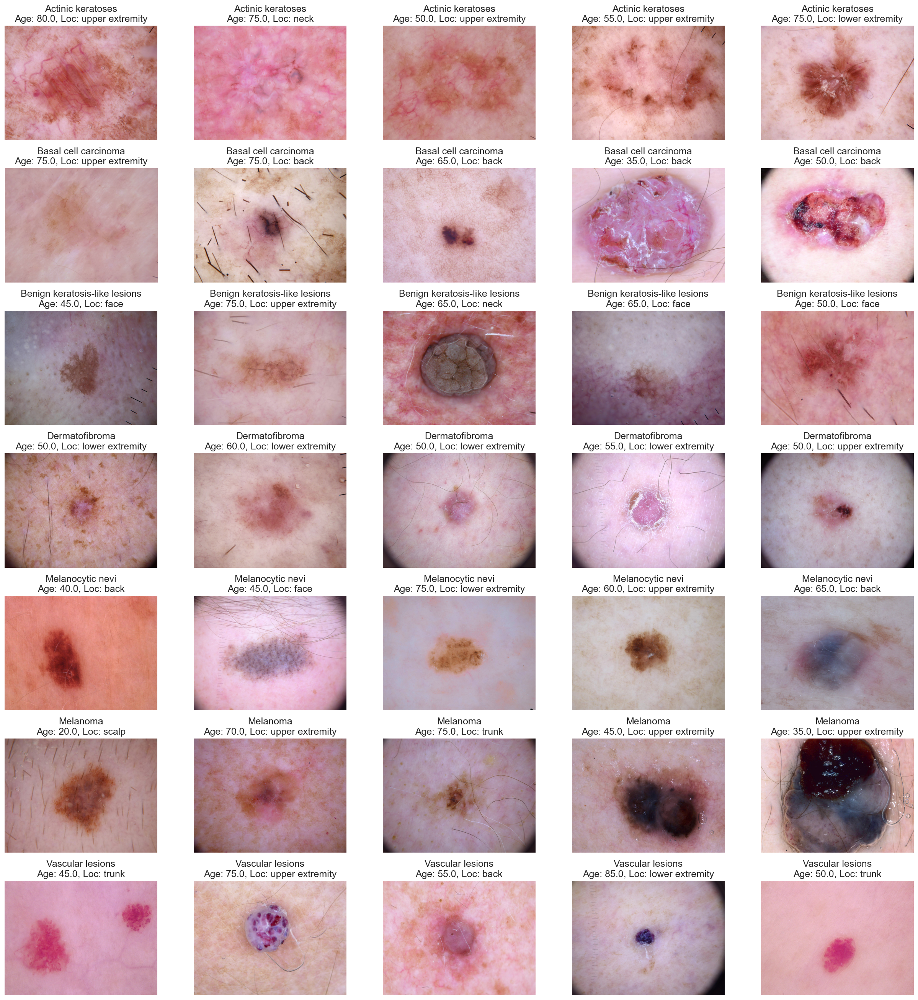

In [ ]:
# Sample images
n_samples = 5
fig, m_axs = plt.subplots(7, n_samples, figsize = (4*n_samples, 3*7))
for n_axs, (type_name, type_rows) in zip(m_axs, 
                                         processed_df.sort_values(['label_fullstr']).groupby('label_fullstr')):
#     n_axs[0].set_title(type_name)
    for c_ax, (_, c_row) in zip(n_axs, type_rows.sample(n_samples, random_state=1234).iterrows()):
        c_ax.imshow(np.asarray(Image.open(c_row['path'])))
        c_ax.set_title('{label_fullstr}\nAge: {age}, Loc: {localization}'.format(**c_row))
        c_ax.axis('off')
plt.tight_layout()
fig.savefig('category_samples.png', dpi=500)

# EDA

## Diagnose method (dx_type)

There are more than 5000 cases were diagnosed using the `Histo method`, `Follow-up` was usually used too then there are a huge gap comparing with the rest methods.

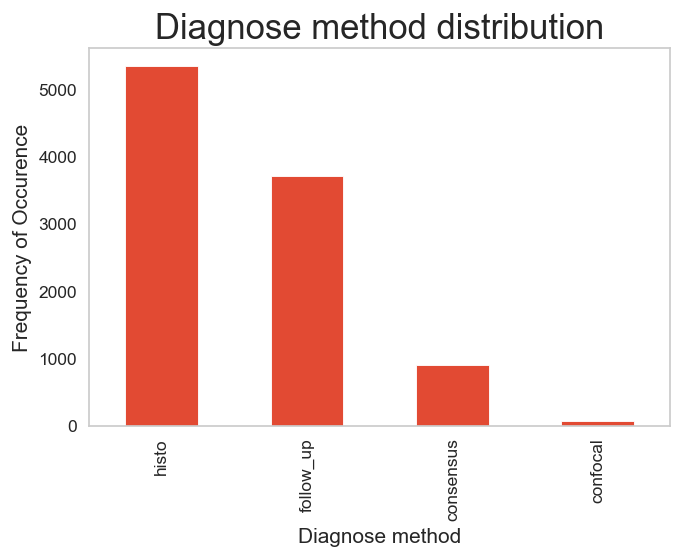

In [ ]:
df['dx_type'].value_counts().plot(kind='bar')
plt.xlabel('Diagnose method')
plt.ylabel('Frequency of Occurence')
plt.title('Diagnose method distribution', fontsize=20);

We can see that for the `nv` cases, `follow_up` method was the most popular method to be utilized to diagnose. In fact, this method is only used largly for this situation. `Histo` can be used for any situations. The rest appears once for a while.

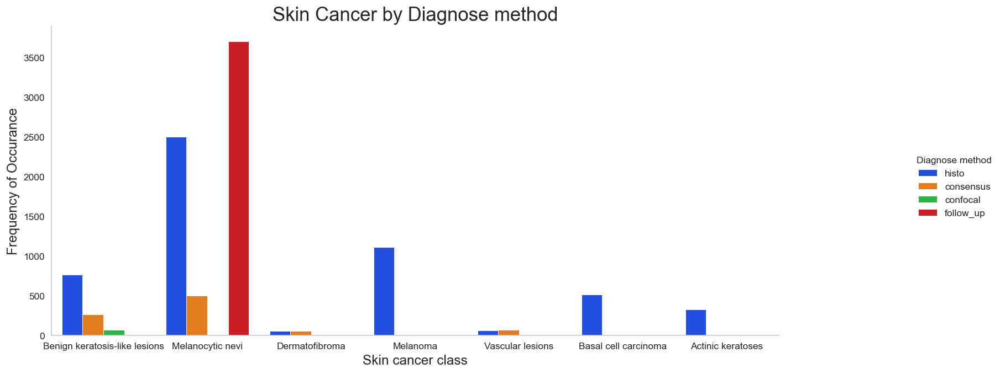

In [ ]:
#Skin Cancer is confirmed via Hispathology, let's check the breakdown for each type
g = sns.catplot(x="label_fullstr", kind="count", hue="dx_type", palette='bright', data=processed_df)
g.fig.set_size_inches(16, 5)

g.ax.set_title('Skin Cancer by Diagnose method', fontsize=20)
g.set_xlabels('Skin cancer class', fontsize=14)
g.set_ylabels('Frequency of Occurance', fontsize=14)
g._legend.set_title('Diagnose method')

## Skin cancer type

The dataset is seriously imbalanced. `nv` class take ~70% of the dataset. On the other hands, the are 4 classes having a proportion < 10%. This would greatly affect the model's performance. There must be some solutions to fight this situation such as: Oversampling, Undersampling, Weighted Loss,...

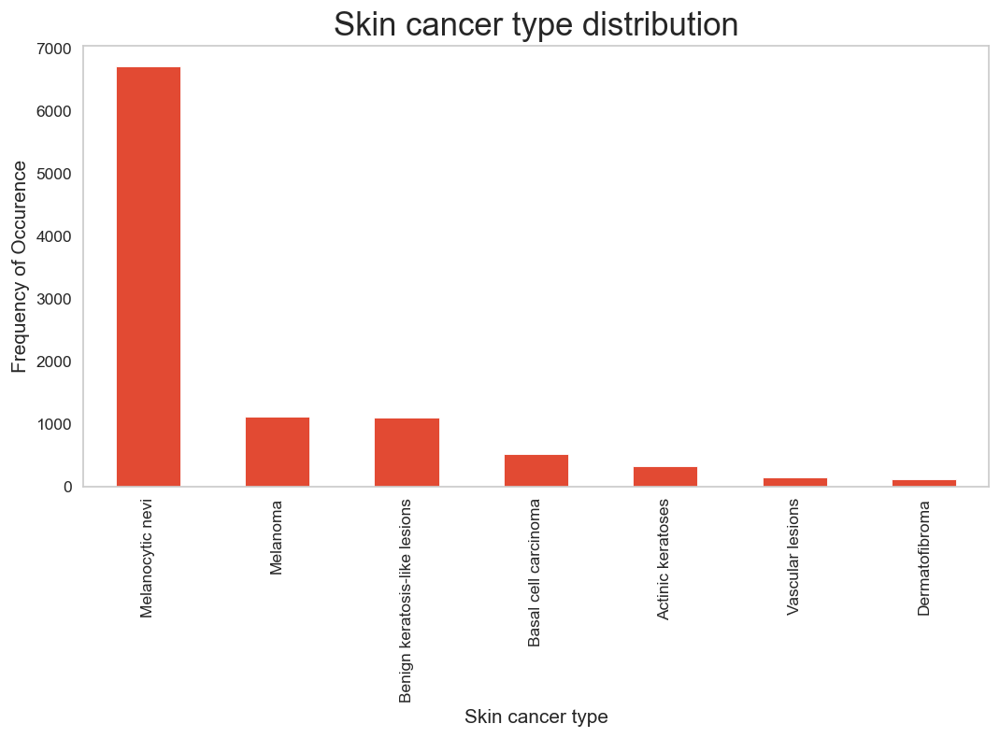

In [ ]:
fig, ax1 = plt.subplots(1, 1, figsize= (10, 5))
processed_df['label_fullstr']\
            .value_counts()\
            .plot(kind='bar', ax=ax1,
#                 color=['tab:blue', 'tab:green', 'tab:red', 'tab:brown', 'tab:gray', 'tab:orange', 'tab:purple']
                 );
plt.xlabel('Skin cancer type')
plt.ylabel('Frequency of Occurence')
plt.title('Skin cancer type distribution', fontsize=20);

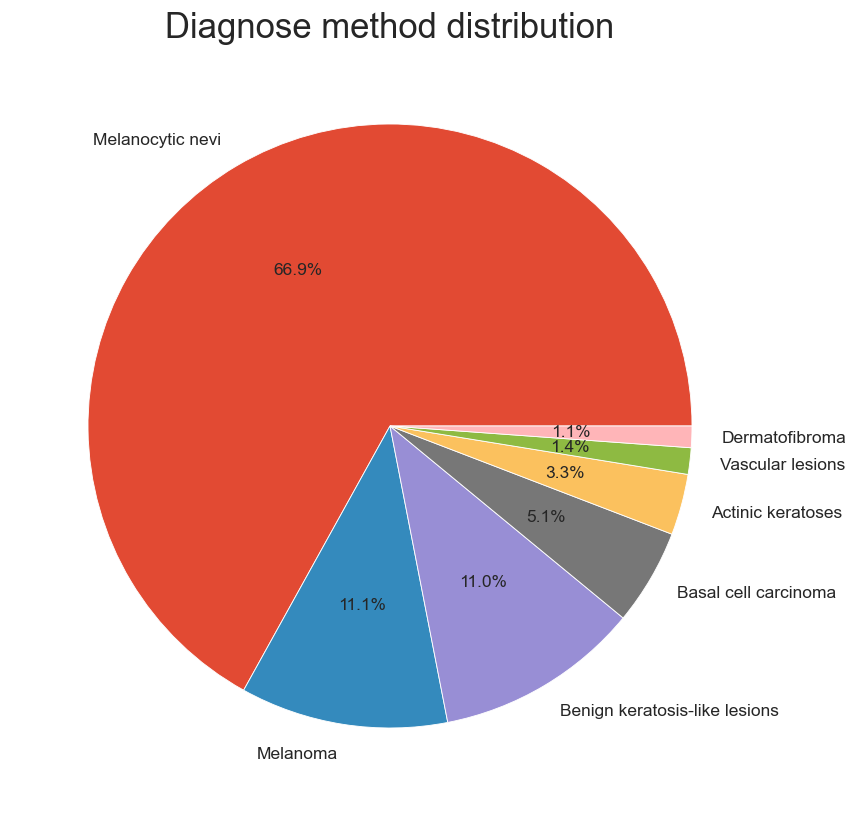

In [ ]:
labels=processed_df.label_fullstr.value_counts().index
sizes=processed_df.label_fullstr.value_counts().values
plt.figure(figsize=(8,8))
plt.pie(sizes,labels=labels,autopct="%1.1f%%")
plt.title("Diagnose method distribution", fontsize=20);

## Location

Text(0.5, 1.0, 'Cancer location distribution')

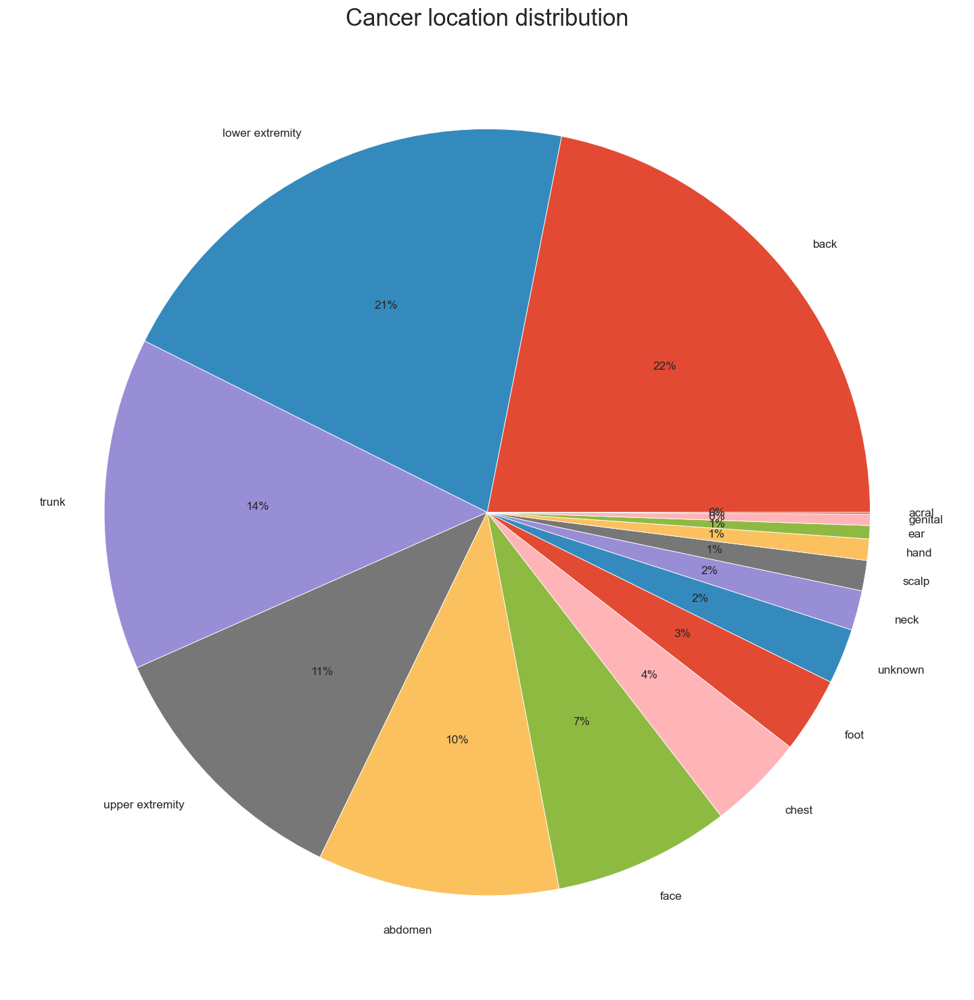

In [ ]:
labels=df.localization.value_counts().index
sizes=df.localization.value_counts().values
plt.figure(figsize=(15,15))
plt.pie(sizes,labels=labels,autopct="%1.f%%")
plt.title("Cancer location distribution", fontsize=20)

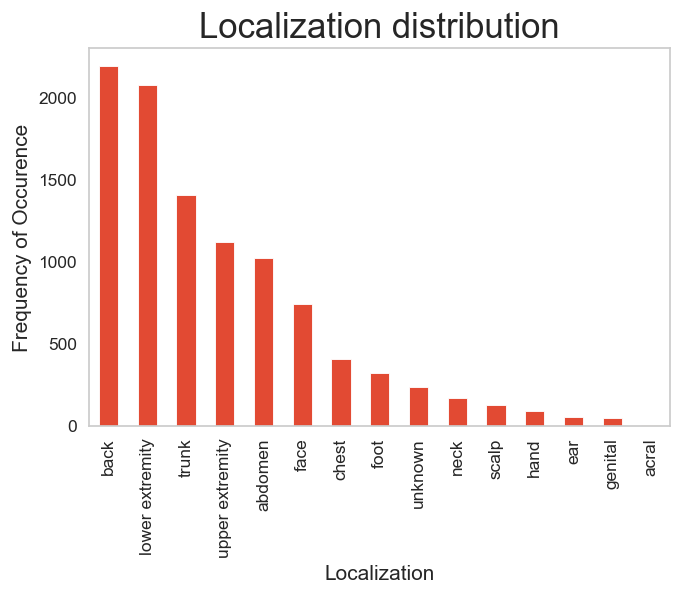

In [ ]:
df['localization'].value_counts().plot(kind='bar')
plt.xlabel('Localization')
plt.ylabel('Frequency of Occurence')
plt.title('Localization distribution', fontsize=20);

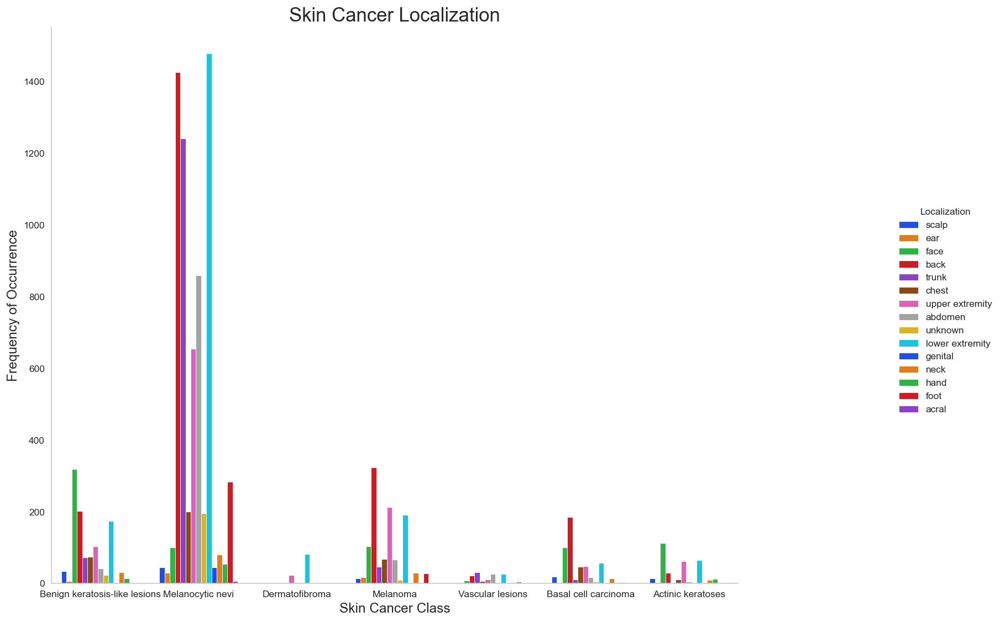

In [ ]:
# Skin Cancer occurence body localization
g = sns.catplot(x="label_fullstr", kind="count", hue="localization", palette='bright', data=processed_df)
g.fig.set_size_inches(16, 9)

g.ax.set_title('Skin Cancer Localization', fontsize=20)
g.set_xlabels('Skin Cancer Class', fontsize=14)
g.set_ylabels('Frequency of Occurrence', fontsize=14)
g._legend.set_title('Localization')

## Age

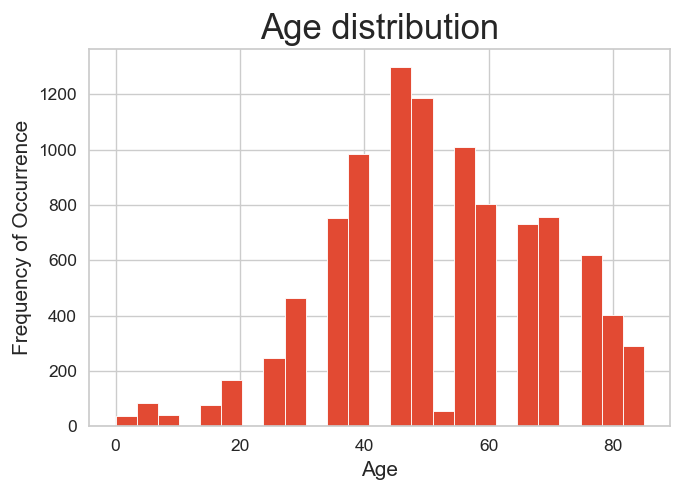

In [ ]:
df['age'].hist(bins=25);
plt.xlabel('Age')
plt.ylabel('Frequency of Occurrence');
plt.title('Age distribution', fontsize=20);

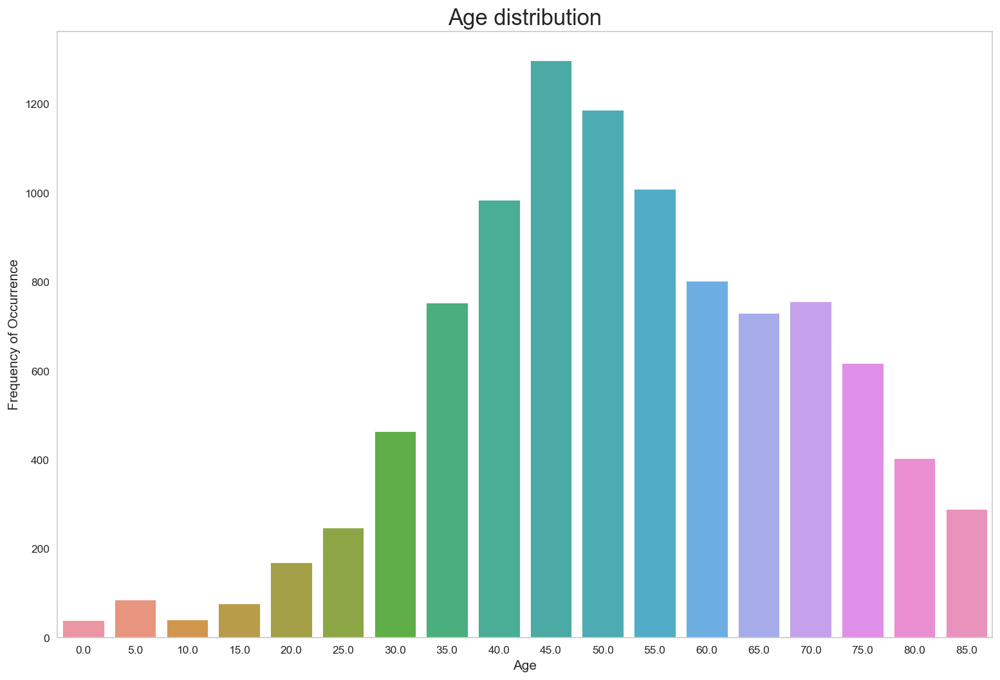

In [ ]:
plt.figure(figsize=(15,10))
g = sns.countplot(x=df.age)
g.set_xlabel('Age')
g.set_ylabel('Frequency of Occurrence')
plt.title("Age distribution", fontsize=20);

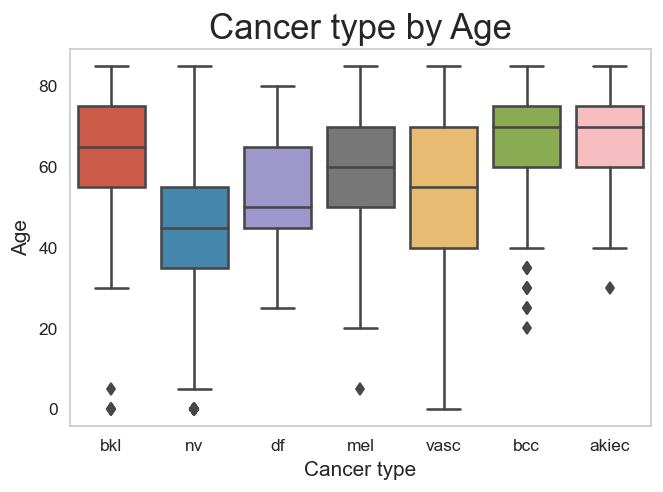

In [ ]:
g = sns.boxplot(x='dx', y='age', data=df);
g.set_xlabel('Cancer type')
g.set_ylabel('Age')
g.set_title('Cancer type by Age', fontsize=20);

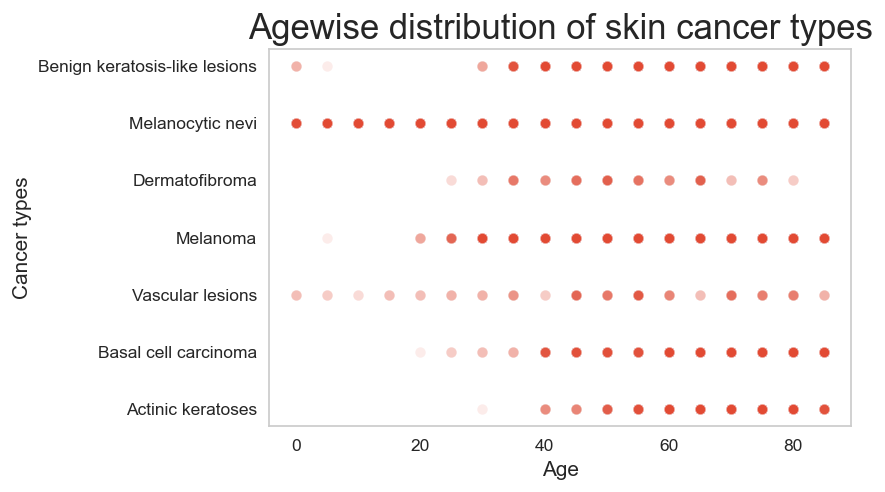

In [ ]:
g = sns.scatterplot(x='age', y='label_fullstr',data=processed_df, alpha=0.1)
g.set_ylabel('Cancer types')
g.set_xlabel('Age')
plt.title('Agewise distribution of skin cancer types', fontsize=20);

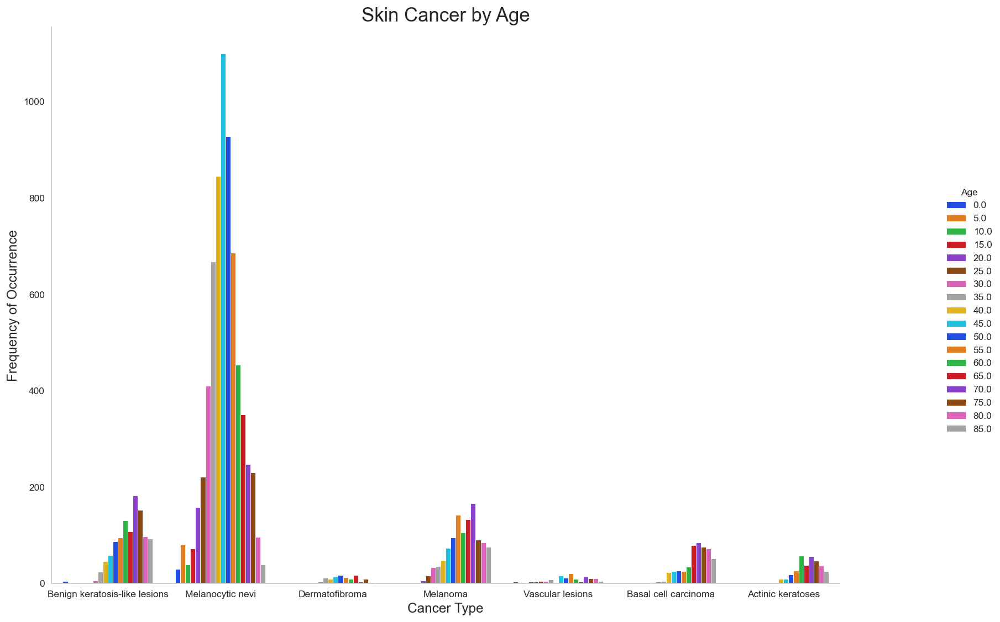

In [ ]:
# Skin Cancer occurence by Age
g = sns.catplot(x="label_fullstr", kind="count", hue="age", palette='bright', data=processed_df)
g.fig.set_size_inches(16, 9)

g.ax.set_title('Skin Cancer by Age', fontsize=20)
g.set_xlabels('Cancer Type', fontsize=14)
g.set_ylabels('Frequency of Occurrence', fontsize=14)
g._legend.set_title('Age')

## Sex

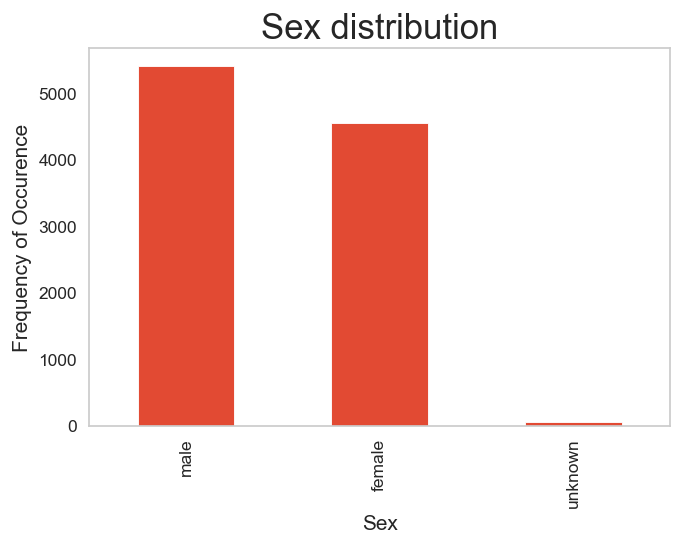

In [ ]:
df['sex'].value_counts().plot(kind='bar')
plt.ylabel('Frequency of Occurence')
plt.xlabel('Sex')
plt.title('Sex distribution', fontsize=20);

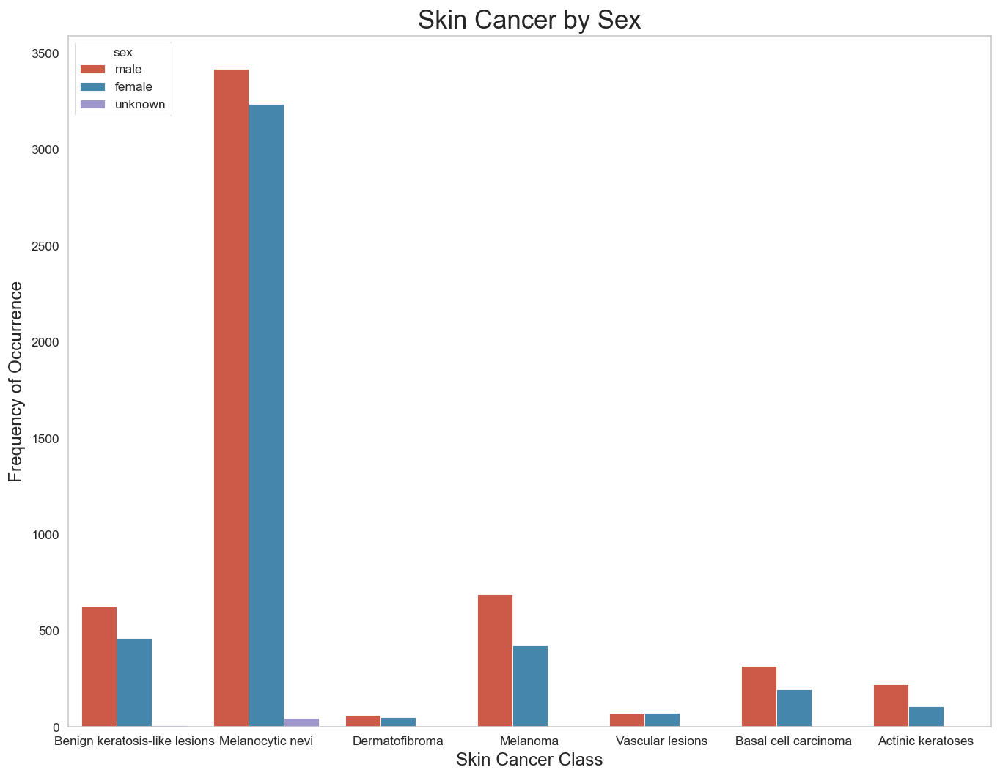

In [ ]:
plt.figure(figsize=(13,10))
g = sns.countplot(x="label_fullstr",hue="sex",data=processed_df)
g.set_xlabel('Skin Cancer Class', fontsize=14)
g.set_ylabel('Frequency of Occurrence', fontsize=14)
g.set_title('Skin Cancer by Sex', fontsize=20);

## Combined

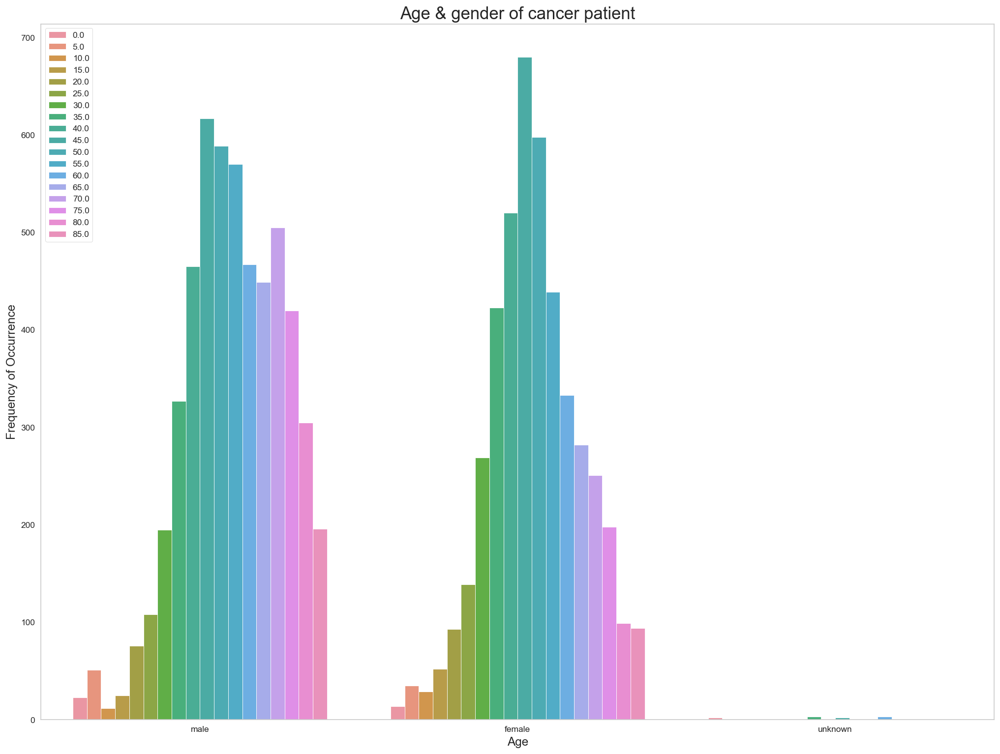

In [ ]:
plt.figure(figsize=(20,15))
sns.countplot(x='sex',hue='age',data=df)
plt.legend(loc='best')
plt.xlabel('Age', fontsize=14)
plt.ylabel('Frequency of Occurrence', fontsize=14)
plt.title("Age & gender of cancer patient",size=20);

## EDA for image feature
For this case, we'd like to observe and handly pick feature from the image property. Since the original image is stored in jpeg and has $2^8$ bits each channel, the colors it can represents is too much for us. So we'll compress it down so that there are only $2^8$ colors can be represented. Then we would calculate the possibility of each color it would be presented in each color channel, using PCA/ TSNE to clamp down the dimensions so we can understand it better. Finally, we would compare each channel's mean and its grayscale's mean for some correlations.

In [ ]:
def color_count_feature(in_path):
    raw_image = Image.open(in_path)
    # Conert to 8-bit images so that we can calculate faster
    web_image = raw_image.convert('P', palette='WEB', dither=None)
    counts, bins = np.histogram(np.array(web_image).ravel(), bins=np.arange(256))
    return counts*1.0/np.prod(web_image.size) # normalize output

In [ ]:
image_subset_df = processed_df.sample(100).copy()
image_subset_df['color_features'] = image_subset_df['path'].map(color_count_feature)
image_subset_df.sample(3)

,lesion_id,image_id,dx,dx_type,age,sex,localization,path,label_fullstr,label_index,val,image,Red_mean,Green_mean,Blue_mean,Gray_mean,color_features
3669,HAM_0005088,ISIC_0031647,nv,follow_up,50.0,female,trunk,D:\Workspace\ML\HAM10000\data/images/ISIC_0031...,Melanocytic nevi,4,0,"[[[245, 168, 176], [247, 172, 179], [248, 169,...",1.308372,0.868591,0.823037,183.635273,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen,D:\Workspace\ML\HAM10000\data/images/ISIC_0033...,Actinic keratoses,0,0,"[[[101, 86, 91], [109, 90, 94], [107, 94, 101]...",1.098938,0.948087,0.952975,200.155536,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
8391,HAM_0006760,ISIC_0031559,nv,histo,35.0,female,abdomen,D:\Workspace\ML\HAM10000\data/images/ISIC_0031...,Melanocytic nevi,4,0,"[[[222, 191, 197], [224, 193, 198], [220, 191,...",1.120178,0.933171,0.946651,187.105340,"[0.0014703703703703704, 0.0, 0.0, 0.0, 0.0, 0...."


In [ ]:
combined_features = np.stack(image_subset_df['color_features'].values, 0)

In [ ]:
from sklearn.decomposition import PCA
xy_pca = PCA(n_components=2)
xy_coords = xy_pca.fit_transform(combined_features)
image_subset_df['x'] = xy_coords[:, 0]
image_subset_df['y'] = xy_coords[:, 1]

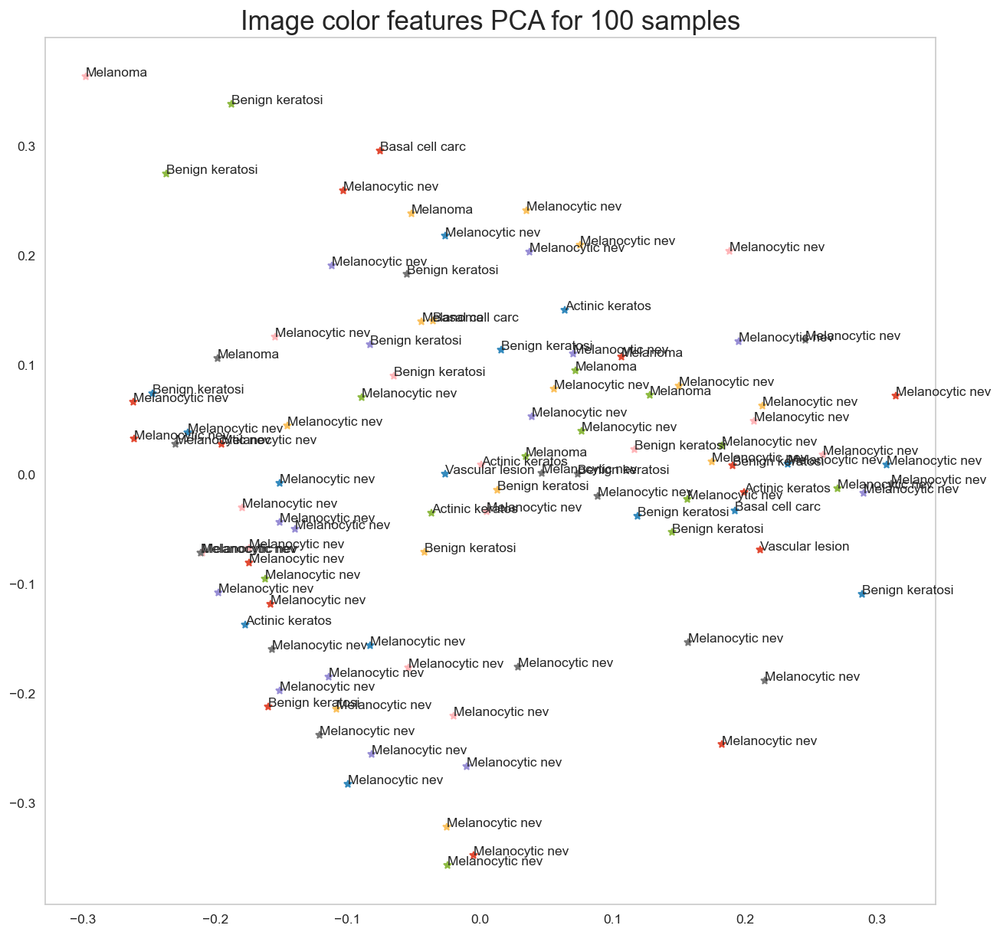

In [ ]:
fig, ax1 = plt.subplots(1,1, figsize=(12, 12))
for _, c_row in image_subset_df.iterrows():
    ax1.plot(c_row['x'], c_row['y'], '*')
    ax1.text(s=c_row['label_fullstr'][:15], x=c_row['x'], y=c_row['y'])
plt.title('Image color features PCA for 100 samples', fontsize=20);

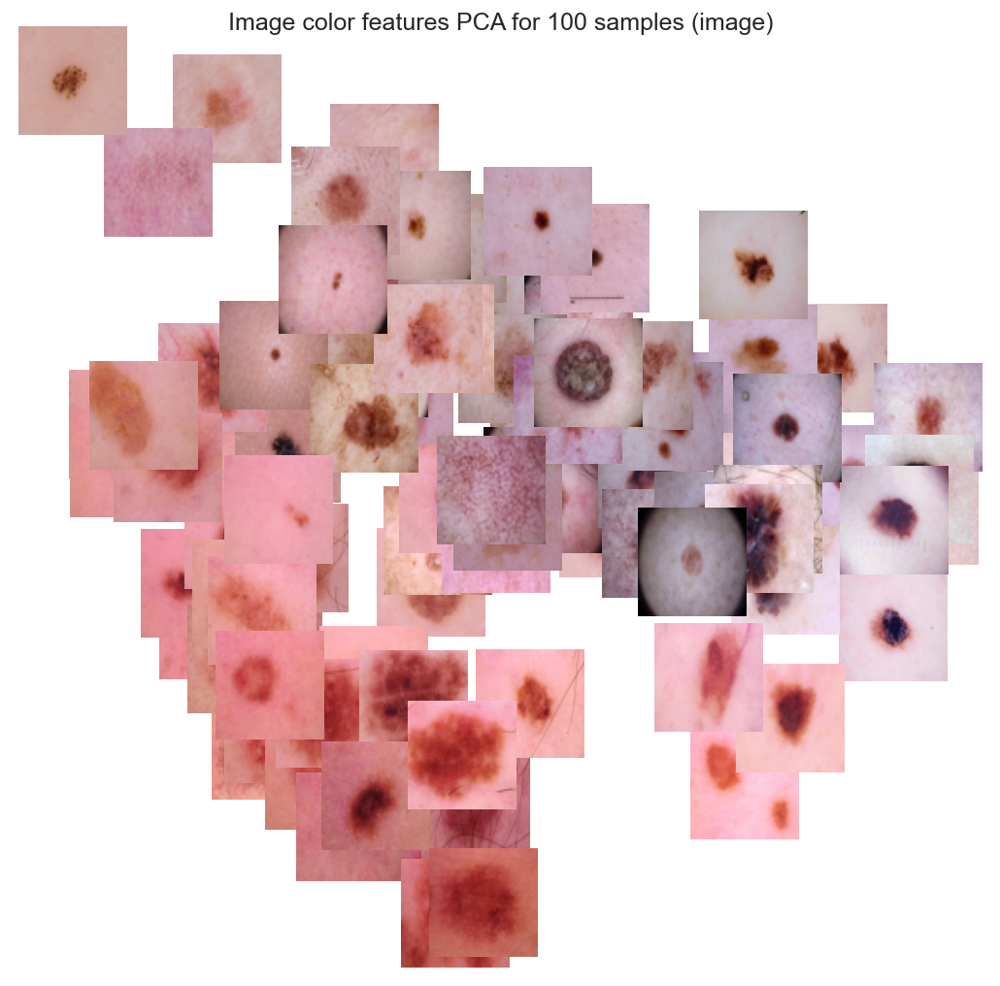

In [ ]:
def show_xy_images(in_df, image_zoom=1):
    fig, ax1 = plt.subplots(1,1, figsize=(10, 10))
    artists = []
    for _, c_row in in_df.iterrows():
        c_img = Image.open(c_row['path']).resize((64, 64))
        img = OffsetImage(c_img, zoom=image_zoom)
        ab = AnnotationBbox(img, (c_row['x'], c_row['y']), xycoords='data', frameon=False)
        artists.append(ax1.add_artist(ab))
    ax1.update_datalim(in_df[['x', 'y']])
    ax1.autoscale()
    ax1.axis('off')
show_xy_images(image_subset_df)
plt.title('Image color features PCA for 100 samples (image)');

In [ ]:
from sklearn.manifold import TSNE
tsne = TSNE(n_iter=250, verbose=True)
xy_coords = tsne.fit_transform(combined_features)
image_subset_df['x'] = xy_coords[:, 0]
image_subset_df['y'] = xy_coords[:, 1]

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 100 samples in 0.000s...
[t-SNE] Computed neighbors for 100 samples in 0.010s...
[t-SNE] Computed conditional probabilities for sample 100 / 100
[t-SNE] Mean sigma: 0.195476
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.300148
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000


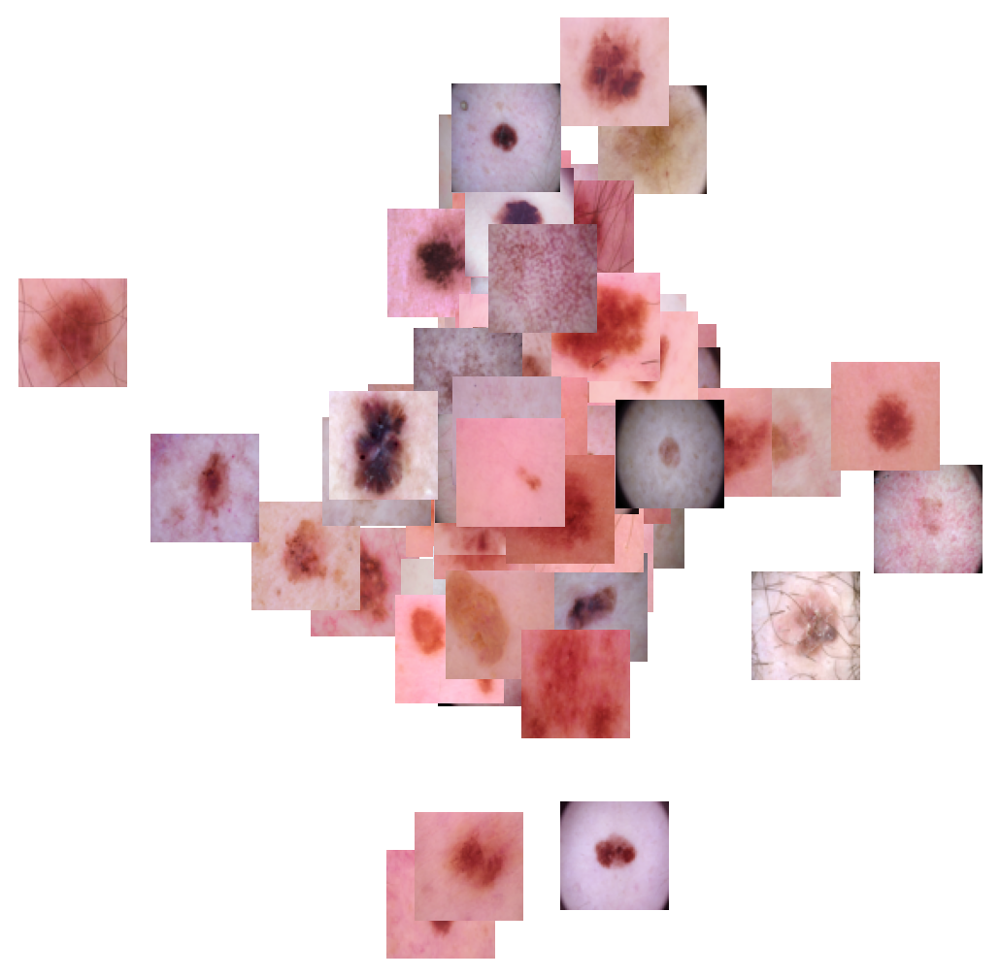

In [ ]:
show_xy_images(image_subset_df)

In [ ]:
from skimage.io import imread
processed_df['image'] = processed_df['path'].map(imread)

In [ ]:
# see the image size distribution
processed_df['image'].map(lambda x: x.shape).value_counts()

(450, 600, 3)    10015
Name: image, dtype: int64

In [ ]:
rgb_info_df = processed_df.apply(lambda x: pd.Series({'{}_mean'.format(k): v for k, v in 
                                  zip(['Red', 'Green', 'Blue'], 
                                      np.mean(x['image'], (0, 1)))}),1)
gray_col_vec = rgb_info_df.apply(lambda x: np.mean(x), 1)
for c_col in rgb_info_df.columns:
    rgb_info_df[c_col] = rgb_info_df[c_col]/gray_col_vec
rgb_info_df['Gray_mean'] = gray_col_vec
rgb_info_df.sample(3)

,Red_mean,Green_mean,Blue_mean,Gray_mean
1774,1.081927,0.899009,1.019064,159.001935
8374,1.109847,0.863244,1.026910,202.298980
2561,1.194013,0.858511,0.947475,144.925854


In [ ]:
for c_col in rgb_info_df.columns:
    processed_df[c_col] = rgb_info_df[c_col].values # we cant afford a copy

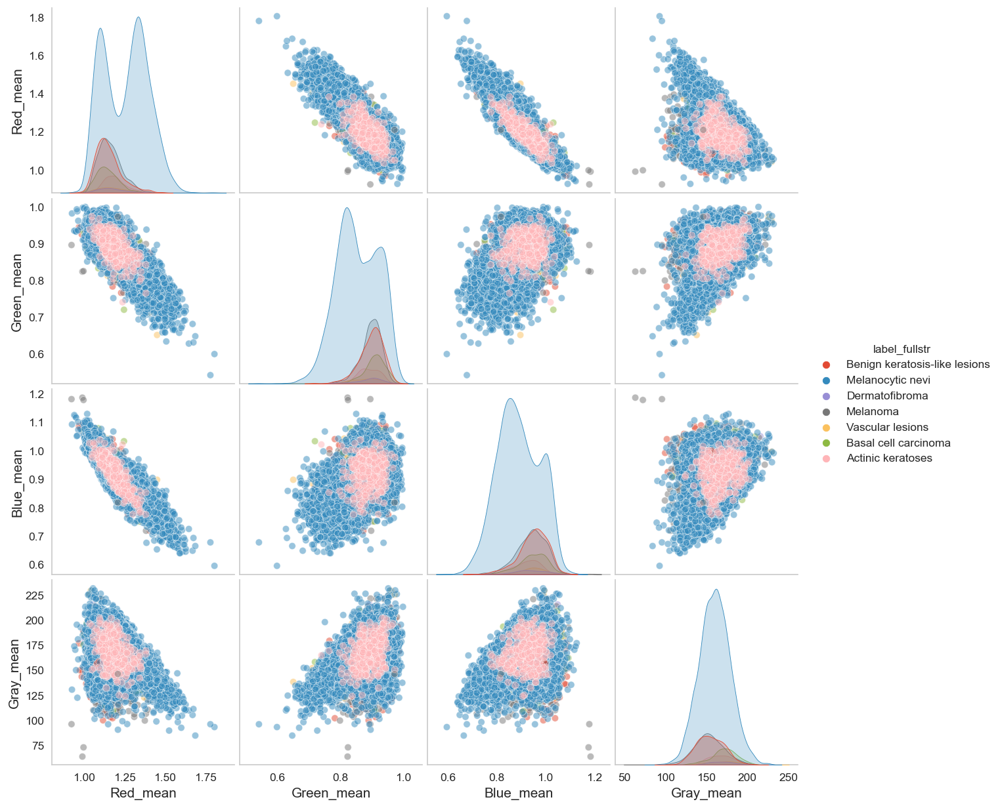

In [ ]:
g = sns.pairplot(processed_df[['Red_mean', 'Green_mean', 'Blue_mean', 'Gray_mean', 'label_fullstr']], 
             hue='label_fullstr', plot_kws = {'alpha': 0.5});

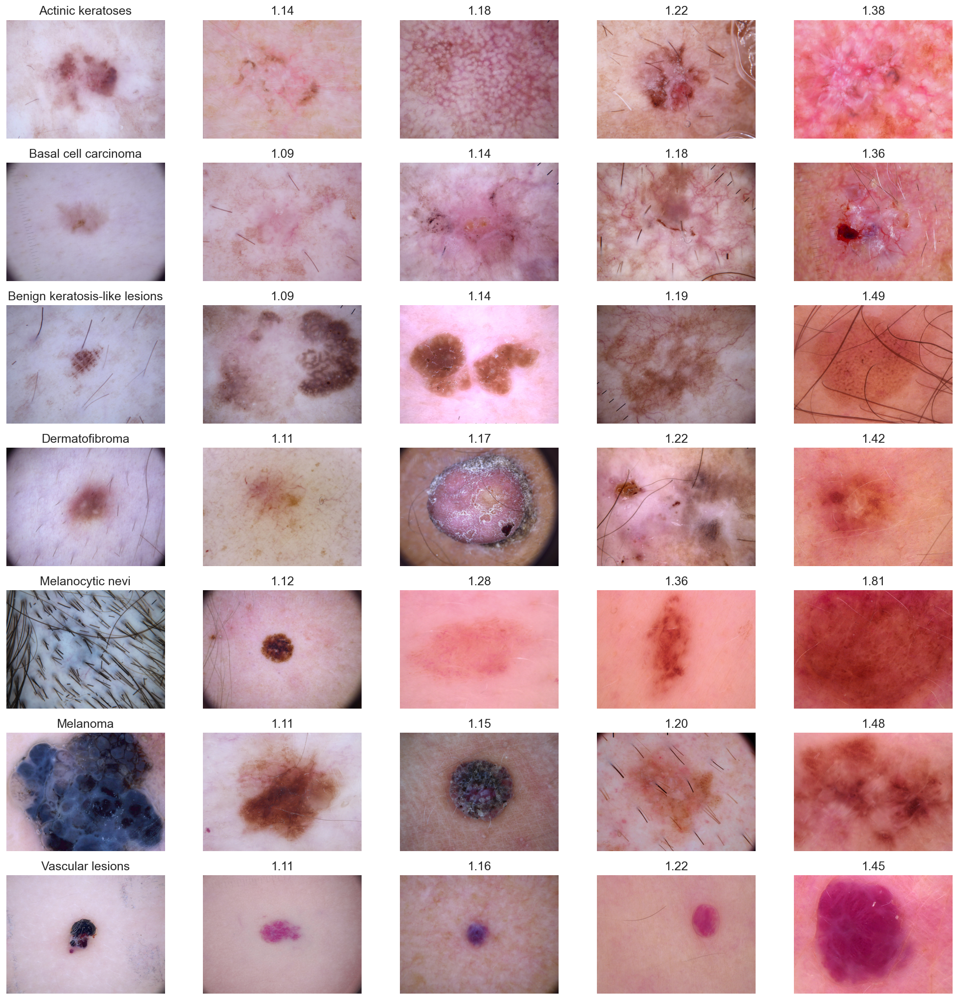

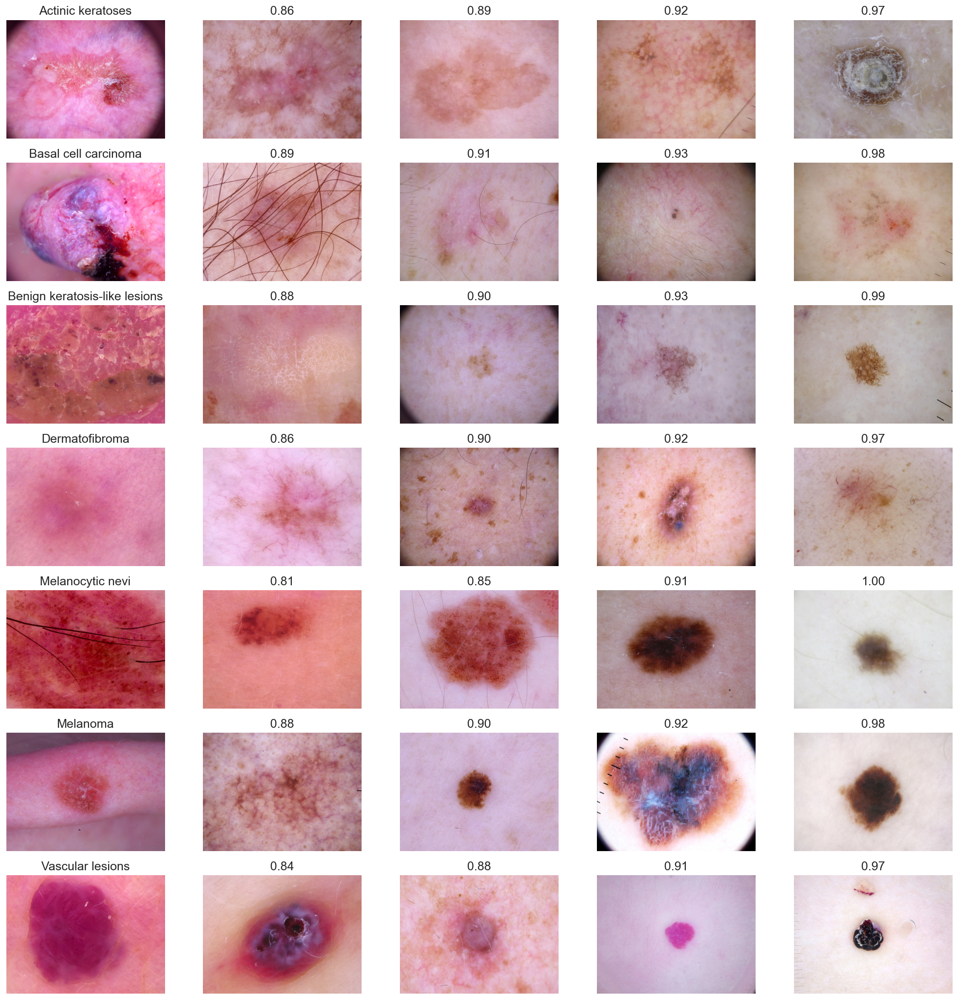

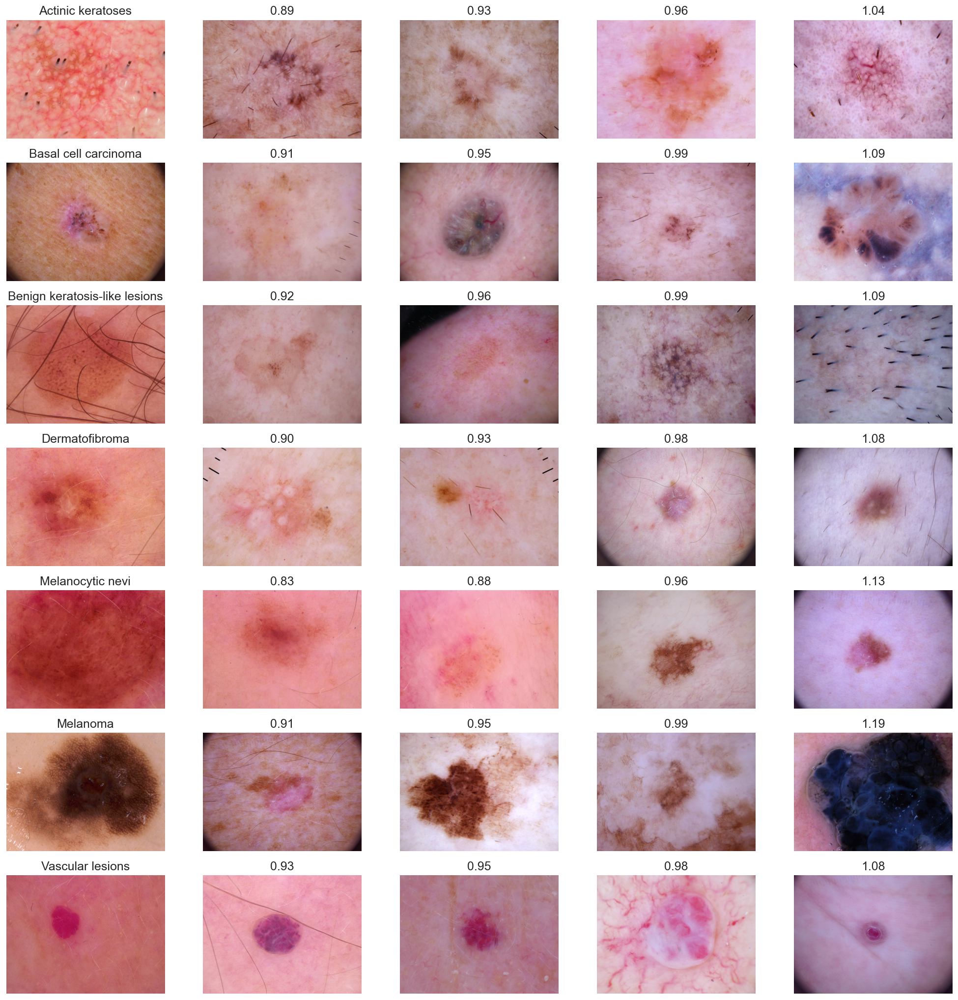

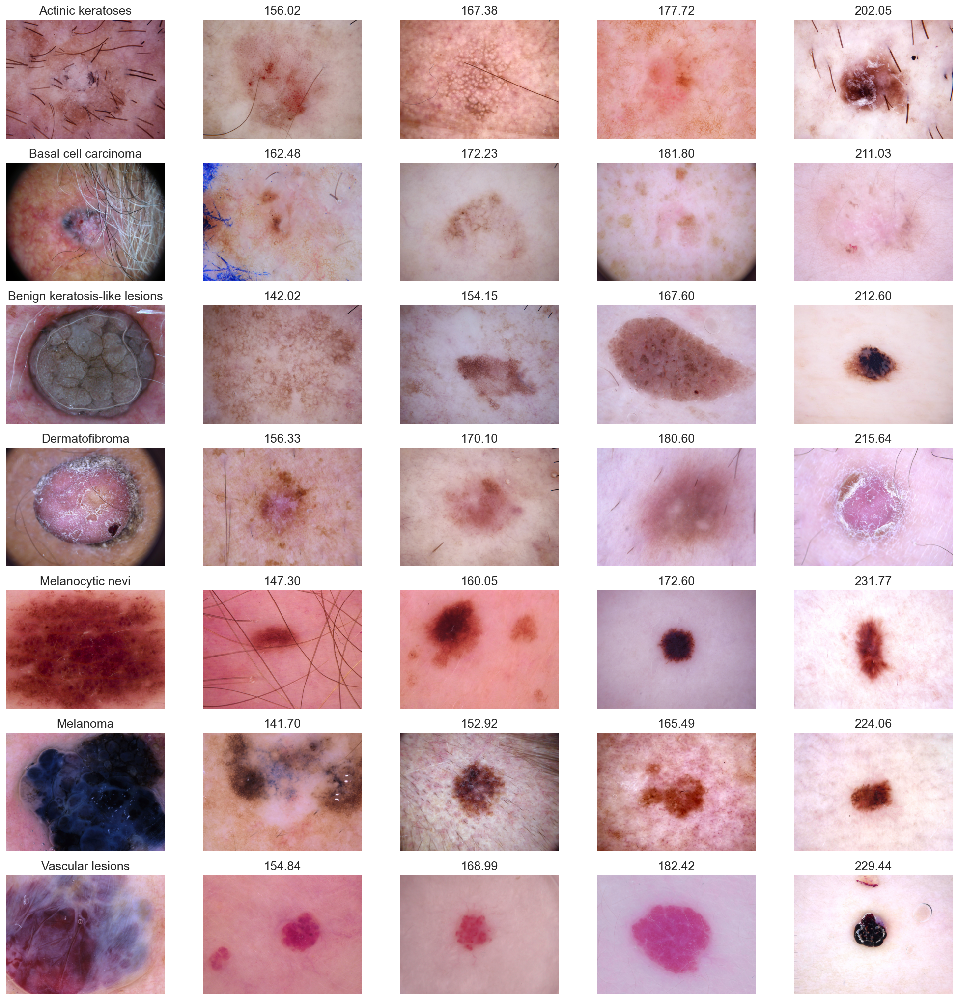

In [ ]:
n_samples = 5
for sample_col in ['Red_mean', 'Green_mean', 'Blue_mean', 'Gray_mean']:
    fig, m_axs = plt.subplots(7, n_samples, figsize = (4*n_samples, 3*7))
    def take_n_space(in_rows, val_col, n):
        s_rows = in_rows.sort_values([val_col])
        s_idx = np.linspace(0, s_rows.shape[0]-1, n, dtype=int)
        return s_rows.iloc[s_idx]
    for n_axs, (type_name, type_rows) in zip(m_axs, 
                                             processed_df.sort_values(['label_fullstr']).groupby('label_fullstr')):

        for c_ax, (_, c_row) in zip(n_axs, 
                                    take_n_space(type_rows, 
                                                 sample_col,
                                                 n_samples).iterrows()):
            c_ax.imshow(c_row['image'])
            c_ax.axis('off')
            c_ax.set_title('{:2.2f}'.format(c_row[sample_col]))
        n_axs[0].set_title(type_name)

    fig.savefig('{}_samples.png'.format(sample_col), dpi=300)

# Train-Valid Split

In [ ]:
df_original = pd.read_csv(PathConfig.CSV_PATH)
df_original.head()

df_undup = df_original.groupby('lesion_id').count()
df_undup = df_undup[df_undup['image_id'] == 1]
df_undup.reset_index(inplace=True)
df_undup.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000001,1,1,1,1,1,1
1,HAM_0000003,1,1,1,1,1,1
2,HAM_0000004,1,1,1,1,1,1
3,HAM_0000007,1,1,1,1,1,1
4,HAM_0000008,1,1,1,1,1,1


In [ ]:
def get_duplicates(x):
    unique_list = list(df_undup['lesion_id'])
    if x in unique_list:
        return 'unduplicated'
    else:
        return 'duplicated'

df_original['duplicates'] = df_original['lesion_id']
df_original['duplicates'] = df_original['duplicates'].apply(get_duplicates)
df_original.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,duplicates
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,duplicated
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,duplicated
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,duplicated
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,duplicated
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,duplicated


In [ ]:
df_original['duplicates'].value_counts()

unduplicated    5514
duplicated      4501
Name: duplicates, dtype: int64

As we can see, there are cases (4501 cases to be exact) having multiple images. This happened since in the dataset, the author tried to augment the same image for some reason. So if we don't carefully pick out sample to split train-valid, we might meet the same-ish image in the validation set, which affect the I.I.D (Independent and identically distribution) property we would want to have. In this case, we will split the dataset using those that aren't duplicated. This is a sample result:

In [ ]:
train_df.count(), valid_df.count()

(lesion_id        8912
 image_id         8912
 dx               8912
 dx_type          8912
 age              8867
 sex              8912
 localization     8912
 path             8912
 label_fullstr    8912
 label_index      8912
 val              8912
 dtype: int64,
 lesion_id        1103
 image_id         1103
 dx               1103
 dx_type          1103
 age              1091
 sex              1103
 localization     1103
 path             1103
 label_fullstr    1103
 label_index      1103
 val              1103
 dtype: int64)

In [ ]:
train_df['label_fullstr'].value_counts()

Melanocytic nevi                 5829
Melanoma                         1061
Benign keratosis-like lesions    1012
Basal cell carcinoma              472
Actinic keratoses                 300
Vascular lesions                  128
Dermatofibroma                    110
Name: label_fullstr, dtype: int64

In [ ]:
valid_df['label_fullstr'].value_counts()

Melanocytic nevi                 876
Benign keratosis-like lesions     87
Melanoma                          52
Basal cell carcinoma              42
Actinic keratoses                 27
Vascular lesions                  14
Dermatofibroma                     5
Name: label_fullstr, dtype: int64

Example of a image and its augmentation implemented by the author:

ISIC_0027419 | ISIC_0025030
- | - 
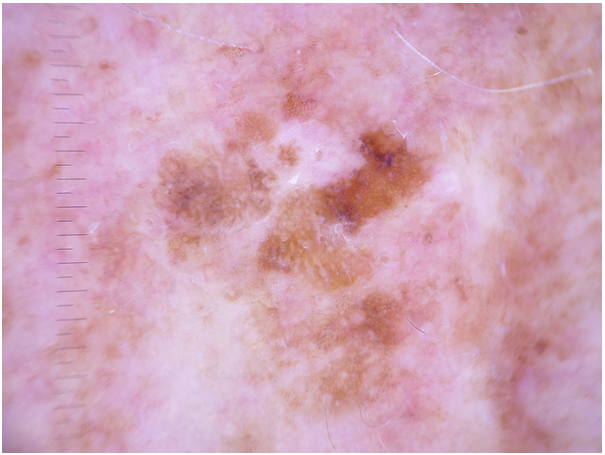 | 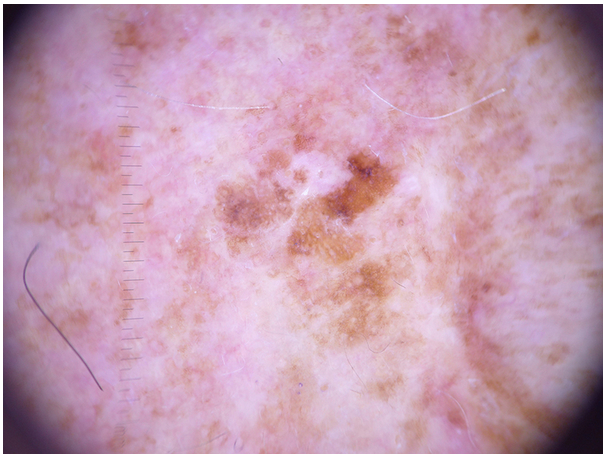

